<a href="https://colab.research.google.com/github/Kusakawama/MADS_CNN/blob/main/POC_WFPrediction_TCAV_SZ.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Masterthesis: Exploring the Use of Explainable AI for Decision Making in the Context of Disaster Risk Management for Wildfires. **POC: TCAV for wildfire occurence classification**
---
Sarah S. Ziegenhagen


## Imports and installments

In [1]:
# Installments
! pip install -q kaggle
! pip install captum
! pip install torch torchvision
! pip install tensorboard
! pip install torchcam
! pip install lime

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 632.4 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 1.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=9d1b35165cf751a6068b45185c31b096db2476fce11a32327fe2f7406666105d
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [2]:
# General imports
import numpy as np
import os, glob
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from google.colab import files
import cv2
import random
import shutil
from PIL import Image
from sklearn.metrics import confusion_matrix
import itertools
from lime import lime_image
import pandas as pd
import seaborn as sns

# Pytorch imports
import torch
#import torchvision
from torch.utils.data import IterableDataset, DataLoader
from torchcam.utils import overlay_mask
import torch.nn as nn
import torchvision.models as models
from torchvision.io import read_image
import torch.optim as optim
from torchvision import datasets, models, transforms
from torchvision.datasets import ImageFolder
from torchcam.methods import GradCAM
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

# Captum imports
from captum.attr import LayerGradientXActivation, LayerIntegratedGradients
from captum.concept import TCAV
from captum.concept import Concept
from captum.concept._utils.data_iterator import dataset_to_dataloader, CustomIterableDataset
from captum.concept._utils.common import concepts_to_str



## Setup

In [3]:
# Check the device - defaults to CPU. TCAV setup does not work on GPU.
# Used Setup: Google Colab T4 V2
device = torch.device("cpu")
print("Using device:", device)

Using device: cpu


# Wildfire Occurence Classification Model

## Wildfire Data Loading and Preprocessing

In [4]:
# connect to the kaggle API to load the datasets
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

Saving kaggle.json to kaggle.json
ref                                                       title                                       size  lastUpdated          downloadCount  voteCount  usabilityRating  
--------------------------------------------------------  -----------------------------------------  -----  -------------------  -------------  ---------  ---------------  
haseebindata/student-performance-predictions              Student Performance Predictions              9KB  2024-08-17 06:57:57           7841        165  0.9411765        
stefanydeoliveira/summer-olympics-medals-1896-2024        Summer Olympics Medals (1896-2024)           4MB  2024-08-29 23:52:10           1499         34  1.0              
lainguyn123/student-performance-factors                   Student Performance Factors                 94KB  2024-09-02 10:53:57           1713         42  1.0              
krupalpatel07/pepsico-daily-data                          PEPSICO Daily Data                         

In [5]:
# download and unzip the wildfire occurence dataset
! kaggle datasets download abdelghaniaaba/wildfire-prediction-dataset
! mkdir -p wildfire-prediction-dataset
! unzip wildfire-prediction-dataset.zip -d wildfire-prediction-dataset

Streaming output truncated to the last 5000 lines.
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465183,45.443641.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465388,45.584881.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.469451,45.480331.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.471252,45.51974.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.472693,45.427766.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.473015,45.435254.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.475051,45.56612.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.477079,45.597274.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.478813,45.555686.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.479478,45.524618.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.480135,45.528248.jpg  
  inflating: wil

In [6]:
# download and unzip the landuse-concept dataset
! kaggle datasets download apollo2506/landuse-scene-classification
! mkdir -p concept-dataset
! unzip landuse-scene-classification.zip -d concept-dataset

Streaming output truncated to the last 5000 lines.
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000365.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000366.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000367.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000368.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000369.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000371.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000372.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000374.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000376.p

In [7]:
# Investigate the dataset

# Dictionary to hold the counts of images and their sizes for each subfolder
wildfire_dir = '/content/wildfire-prediction-dataset'
folder_image_count = {}
image_sizes = {}

# List of subfolders to investigate
subfolders = ['train', 'test', 'valid']

# Iterate through each subfolder
for subfolder in subfolders:
    subfolder_path = os.path.join(wildfire_dir, subfolder)
    folder_image_count[subfolder] = 0

    # Iterate through each folder (concept) within the subfolder
    for folder_name in os.listdir(subfolder_path):
        folder_path = os.path.join(subfolder_path, folder_name)
        if os.path.isdir(folder_path):
            for image_name in os.listdir(folder_path):
                image_path = os.path.join(folder_path, image_name)
                try:
                    with Image.open(image_path) as img:
                        img_size = img.size
                        folder_image_count[subfolder] += 1
                        if img_size not in image_sizes:
                            image_sizes[img_size] = 0
                        image_sizes[img_size] += 1
                except Exception as e:
                    print(f"Error loading image {image_path} in {subfolder}/{folder_name}: {e}")

# Print the results
print("Image counts by subfolder:", folder_image_count)
print("Image sizes frequency:", image_sizes)

Image counts by subfolder: {'train': 30250, 'test': 6300, 'valid': 6300}
Image sizes frequency: {(350, 350): 42850}


In [8]:
# Define the paths to the wildfire data
train_dir = '/content/wildfire-prediction-dataset/train'
val_dir = '/content/wildfire-prediction-dataset/valid'
test_dir = '/content/wildfire-prediction-dataset/test'

Image: /content/wildfire-prediction-dataset/train/wildfire/-66.12309,50.22512.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-72.79176,49.53058.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-79.30541,47.43285.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-74.5053,49.80756.jpg
Image: /content/wildfire-prediction-dataset/train/wildfire/-68.91936,52.16757.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-75.769558,45.339327.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-114.173522,51.057303.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-123.093201,49.116966.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-122.952602,49.227548.jpg
Image: /content/wildfire-prediction-dataset/train/nowildfire/-79.297024,43.702212.jpg


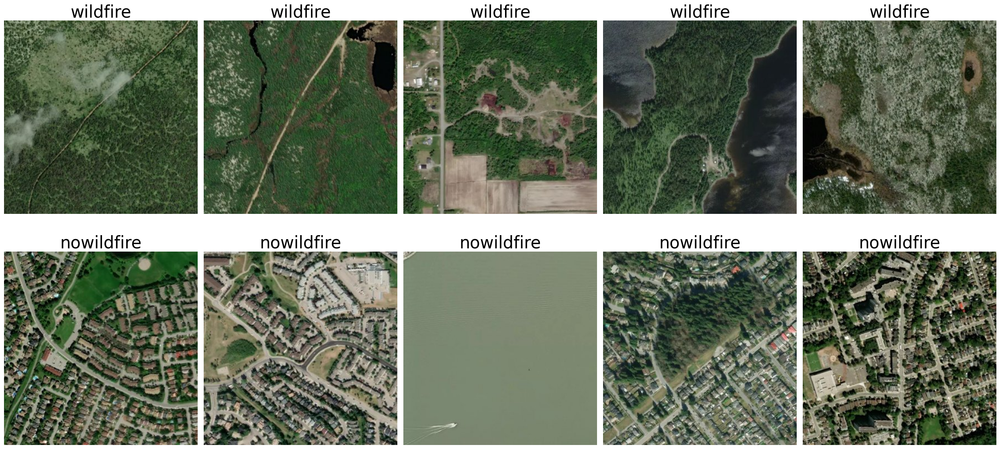

In [9]:
# Define the class names and number of images to display per class
class_names = ['wildfire', 'nowildfire']
image_count = 5  # Number of images to display per class

# Create the subplots with adjusted spacing
fig, axs = plt.subplots(2, image_count, figsize=(25, 12))  # Increase the figsize height

# Adjust the vertical space between the rows
plt.subplots_adjust(hspace=0.3)  # Increase hspace to add more space between rows

# Loop through each class and display images
for row, class_name in enumerate(class_names):
    class_folder = os.path.join(train_dir, class_name)
    image_files = glob.glob(os.path.join(class_folder, '*.*'))[:image_count]

    for col, image_file in enumerate(image_files):
        img = plt.imread(image_file)
        axs[row, col].imshow(img)
        axs[row, col].axis('off')
        axs[row, col].set_title(class_name, fontsize=30)
        print(f"Image: {image_file}")


plt.tight_layout()
plt.show()

In [10]:
# Define a data loader using CV2
def cv2_loader(path):
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return Image.fromarray(img)

In [11]:
# Set the data transformations to ensure consistent formats and compatibility
# Std. and mean from imagenet data used as this is what the model is originaly trained on
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])


In [12]:
# Load the train, test and validation datasets applying the defined transformations

# Load training data
train_dataset = ImageFolder(root=train_dir, transform=data_transforms, loader=cv2_loader)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Load validation data
val_dataset = ImageFolder(root=val_dir, transform=data_transforms, loader=cv2_loader)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Load test data
test_dataset = ImageFolder(root=test_dir, transform=data_transforms, loader=cv2_loader)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

## Model Training
A ResNet50 with Imagent weights is initialized and fined tuned for the purpose of wildfirce occurence prediction in the form of a binary classification.

Moving forward, this model was saved and loaded for analysis to be mindful of computational resources and ensure consistent results.

In [ ]:
# Initiate the pretrained ResNet50
model = models.resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 197MB/s]


In [ ]:
# Define the fully connected layers for the binary classification (2 classes: wildifre, nowildfire)
model.fc = nn.Linear(model.fc.in_features, 2)
#model = model.to('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
# Define hyperparameters
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
num_epochs = 10

In [ ]:
'''# Train the model and print epochs, loss and accuracy

#device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Iterate over the epochs (10)
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/len(train_loader):.4f}")

    # Validate the model after each epoch to track validation accuracy overtime
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    print(f"Validation Accuracy after Epoch {epoch+1}: {correct/total * 100:.2f}%")

'''

Epoch 1/10, Loss: 0.1460
Validation Accuracy after Epoch 1: 94.94%
Epoch 2/10, Loss: 0.1026
Validation Accuracy after Epoch 2: 96.94%
Epoch 3/10, Loss: 0.0803
Validation Accuracy after Epoch 3: 98.10%
Epoch 4/10, Loss: 0.0693
Validation Accuracy after Epoch 4: 96.79%
Epoch 5/10, Loss: 0.0650
Validation Accuracy after Epoch 5: 98.25%
Epoch 6/10, Loss: 0.0556
Validation Accuracy after Epoch 6: 97.17%
Epoch 7/10, Loss: 0.0520
Validation Accuracy after Epoch 7: 97.71%
Epoch 8/10, Loss: 0.0625
Validation Accuracy after Epoch 8: 97.68%
Epoch 9/10, Loss: 0.0441
Validation Accuracy after Epoch 9: 98.63%
Epoch 10/10, Loss: 0.0420
Validation Accuracy after Epoch 10: 97.92%


In [ ]:
def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer):
    device = 'cpu'
    model = model.to(device)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            correct_train += (preds == labels).sum().item()
            total_train += labels.size(0)

        epoch_loss = running_loss / len(train_loader)
        epoch_acc = correct_train / total_train

        # Log training loss and accuracy
        #writer.add_scalar('Loss/train', epoch_loss, epoch)
        #writer.add_scalar('Accuracy/train', epoch_acc, epoch)

        # Validate the model after each epoch
        model.eval()
        correct_val = 0
        total_val = 0
        running_val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                running_val_loss += loss.item()
                _, preds = torch.max(outputs, 1)
                correct_val += (preds == labels).sum().item()
                total_val += labels.size(0)

        epoch_val_loss = running_val_loss / len(val_loader)
        epoch_val_acc = correct_val / total_val

        # Log validation loss and accuracy
        writer.add_scalars('Loss', {'Train_loss': epoch_loss,'Val_loss': epoch_val_loss}, epoch)
        writer.add_scalars('Accuracy', {'Train_accuracy': epoch_acc, 'Val_accuracy':epoch_val_acc}, epoch)

        print(f"Epoch {epoch+1}/{num_epochs}, "
              f"Train Loss: {epoch_loss:.4f}, Train Acc: {epoch_acc:.4f}, "
              f"Val Loss: {epoch_val_loss:.4f}, Val Acc: {epoch_val_acc:.4f}")




In [ ]:
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.figure(figsize=(6,6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [ ]:
'''def log_confusion_matrix(model, test_loader, writer):
    device = 'cpu'  # Set device to CPU
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.numpy())
            all_labels.extend(labels.numpy())

    cm = confusion_matrix(all_labels, all_preds)
    plot_confusion_matrix(cm, classes=['nowildfire', 'wildfire'], title='Confusion Matrix')

    # Log confusion matrix as an image
    fig = plt.figure(figsize=(8, 8))
    plot_confusion_matrix(cm, classes=['nowildfire', 'wildfire'], title='Confusion Matrix')
    writer.add_figure('Confusion Matrix', fig)'''

In [ ]:
train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer)

Epoch 1/10, Train Loss: 0.1479, Train Acc: 0.9457, Val Loss: 0.0885, Val Acc: 0.9670
Epoch 2/10, Train Loss: 0.1000, Train Acc: 0.9643, Val Loss: 0.1102, Val Acc: 0.9594
Epoch 3/10, Train Loss: 0.0807, Train Acc: 0.9709, Val Loss: 0.2458, Val Acc: 0.8943
Epoch 4/10, Train Loss: 0.0672, Train Acc: 0.9762, Val Loss: 0.0874, Val Acc: 0.9711
Epoch 5/10, Train Loss: 0.0605, Train Acc: 0.9782, Val Loss: 0.0969, Val Acc: 0.9632
Epoch 6/10, Train Loss: 0.0576, Train Acc: 0.9804, Val Loss: 0.0784, Val Acc: 0.9727
Epoch 7/10, Train Loss: 0.0507, Train Acc: 0.9822, Val Loss: 0.1180, Val Acc: 0.9581
Epoch 8/10, Train Loss: 0.0502, Train Acc: 0.9823, Val Loss: 0.0724, Val Acc: 0.9743
Epoch 9/10, Train Loss: 0.0459, Train Acc: 0.9840, Val Loss: 0.4123, Val Acc: 0.8465
Epoch 10/10, Train Loss: 0.0408, Train Acc: 0.9859, Val Loss: 0.0770, Val Acc: 0.9735


In [ ]:
'''log_confusion_matrix(model, test_loader, writer)'''

'log_confusion_matrix(model, test_loader, writer)'

Training output:
Epoch 1/10, Train Loss: 0.1479, Train Acc: 0.9457, Val Loss: 0.0885, Val Acc: 0.9670
Epoch 2/10, Train Loss: 0.1000, Train Acc: 0.9643, Val Loss: 0.1102, Val Acc: 0.9594
Epoch 3/10, Train Loss: 0.0807, Train Acc: 0.9709, Val Loss: 0.2458, Val Acc: 0.8943
Epoch 4/10, Train Loss: 0.0672, Train Acc: 0.9762, Val Loss: 0.0874, Val Acc: 0.9711
Epoch 5/10, Train Loss: 0.0605, Train Acc: 0.9782, Val Loss: 0.0969, Val Acc: 0.9632
Epoch 6/10, Train Loss: 0.0576, Train Acc: 0.9804, Val Loss: 0.0784, Val Acc: 0.9727
Epoch 7/10, Train Loss: 0.0507, Train Acc: 0.9822, Val Loss: 0.1180, Val Acc: 0.9581
Epoch 8/10, Train Loss: 0.0502, Train Acc: 0.9823, Val Loss: 0.0724, Val Acc: 0.9743
Epoch 9/10, Train Loss: 0.0459, Train Acc: 0.9840, Val Loss: 0.4123, Val Acc: 0.8465
Epoch 10/10, Train Loss: 0.0408, Train Acc: 0.9859, Val Loss: 0.0770, Val Acc: 0.9735

### Tensorboard visualisation

In [ ]:
writer.flush()

In [ ]:
writer.close()

In [ ]:
%matplotlib inline

In [ ]:
%load_ext tensorboard

In [ ]:
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

### Evaluation

In [ ]:
# Evaluate the model using the test data
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 98.16%


Output:

Test Accuracy: 98.16%

The test accuracy of 98.16% is even higher than the validation accuracy during training, which was 97.35% at the last epoch and similar to the training accuracy, which was 98.59% at the last epoch. Hence, the model does not appear to either overfit or underit while classifying correctly with a high accuracy.

In [ ]:
# Save the model to use accross sessions
torch.save(model.state_dict(), 'resnet50_torch_wfclassification.pth')
files.download('/content/resnet50_torch_wfclassification.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Confusion matrix, without normalization


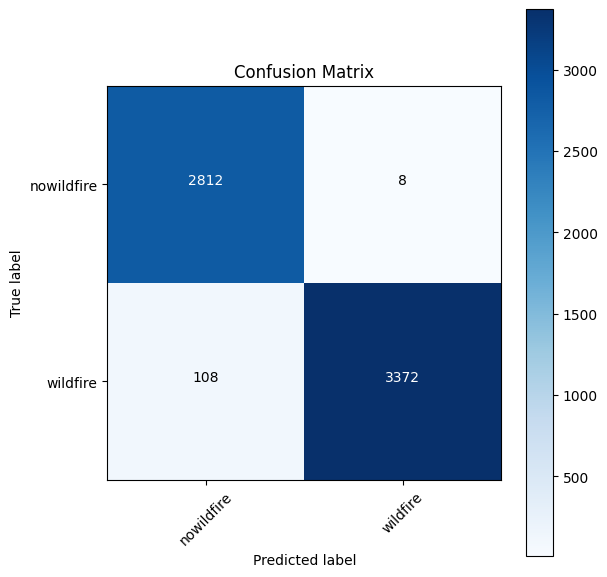

In [ ]:
model.eval()
all_preds = []
all_labels = []

with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        all_preds.extend(preds.numpy())
        all_labels.extend(labels.numpy())

cm = confusion_matrix(all_labels, all_preds)
plot_confusion_matrix(cm, classes=['nowildfire', 'wildfire'], title='Confusion Matrix')

## Model Loading

In [13]:
# Load the trained model
# Initiate the ResNet50 architecture without the weights
model_loaded = models.resnet50(pretrained=False)
model_loaded.fc = nn.Linear(model_loaded.fc.in_features, 2)

# Load the learned weights
model_loaded.load_state_dict(torch.load('/content/resnet50_torch_wfclassification.pth', map_location=torch.device('cpu'), weights_only=True))
#model = model.to('cuda' if torch.cuda.is_available() else 'cpu')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


<All keys matched successfully>

In [14]:
# Evaluate the model again to ensure correct behavior when loading.
# The test accuracy is expected to be the same as originally (98.16%)
model_loaded.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model_loaded(inputs)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 98.16%


## Investigate misclassified images

In [ ]:
from torchvision.datasets import ImageFolder

class ImageFolderWithPaths(ImageFolder):
    # Override the __getitem__ method to also return the image file path
    def __getitem__(self, index):
        # Get the original tuple (image, label)
        original_tuple = super(ImageFolderWithPaths, self).__getitem__(index)

        # The image file path
        path = self.imgs[index][0]

        # Return a new tuple that includes the path
        return original_tuple + (path,)


In [ ]:
# Load test data
test_dataset_path = ImageFolderWithPaths(root=test_dir, transform=data_transforms, loader=cv2_loader)
test_loader_path = DataLoader(test_dataset_path, batch_size=32, shuffle=False)


In [ ]:
model_loaded.eval()
misclassified_paths = []
misclassified_labels = []
misclassified_preds = []
wildfire_class_names = ['nowildfire', 'wildfire']

with torch.no_grad():
    for inputs, labels, paths in test_loader_path:  # Now paths are also returned
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model_loaded(inputs)
        _, preds = torch.max(outputs, 1)

        for i in range(len(labels)):
            if preds[i] != labels[i]:  # If prediction is incorrect
                misclassified_paths.append(paths[i])
                misclassified_labels.append(labels[i].cpu().item())
                misclassified_preds.append(preds[i].cpu().item())

def show_misclassified_images_by_path(image_paths, true_labels, pred_labels, target_label, num_images=5):
    images_shown = 0
    shown_image_paths = []
    fig = plt.figure(figsize=(25, 5))  # Adjusted the figure size for image display
    for i in range(len(image_paths)):
        if true_labels[i] == target_label and images_shown < num_images:
            ax = fig.add_subplot(1, num_images, images_shown + 1, xticks=[], yticks=[])
            img = Image.open(image_paths[i])  # Load image from the path
            true_class_name = wildfire_class_names[true_labels[i]]
            #print(f"true labels i : {true_labels[i]}")
            #print(f"pred labels i : {pred_labels[i]}")
            pred_class_name = wildfire_class_names[pred_labels[i]]
            ax.imshow(img)
            ax.set_title(f'True: {true_class_name}\nPred: {pred_class_name}')
            shown_image_paths.append(image_paths[i])  # Collect paths of displayed images
            images_shown += 1
        if images_shown == num_images:
            break

    #return shown_image_paths
    plt.show()

    # Print the list of image paths
    print("Paths of the misclassified images shown:")
    for path in shown_image_paths:
        print(path)

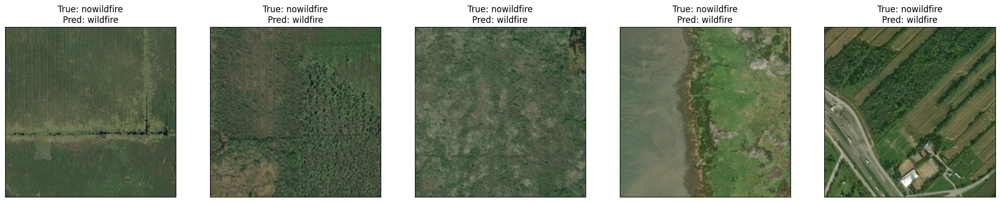

Paths of the misclassified images shown:
/content/wildfire-prediction-dataset/test/nowildfire/-122.947084,49.119961.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-122.957795,49.119955.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-123.012371,49.111431.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-123.199805,49.152146.jpg
/content/wildfire-prediction-dataset/test/nowildfire/-73.413811,45.436142.jpg


In [ ]:
# Display 5 misclassified 'nowildfire' images
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=0, num_images=5)

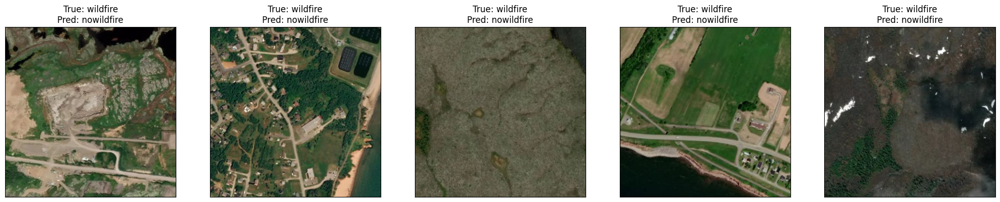

Paths of the misclassified images shown:
/content/wildfire-prediction-dataset/test/wildfire/-60.6867,50.26079.jpg
/content/wildfire-prediction-dataset/test/wildfire/-61.87285,47.36931.jpg
/content/wildfire-prediction-dataset/test/wildfire/-62.62616,51.56745.jpg
/content/wildfire-prediction-dataset/test/wildfire/-65.6656,48.0986.jpg
/content/wildfire-prediction-dataset/test/wildfire/-66.25743,51.3227.jpg


In [ ]:
# Display 5 misclassified 'wildfire' images
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=1, num_images=5)

In [ ]:
'''# Display 5 misclassified 'nowildfire' images
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=0, num_images=5)

# Display 5 misclassified 'wildfire' images
show_misclassified_images_by_path(misclassified_paths, misclassified_labels, misclassified_preds, target_label=1, num_images=5)'''

## Lime and GradCAM

Image shape: torch.Size([1, 3, 224, 224])


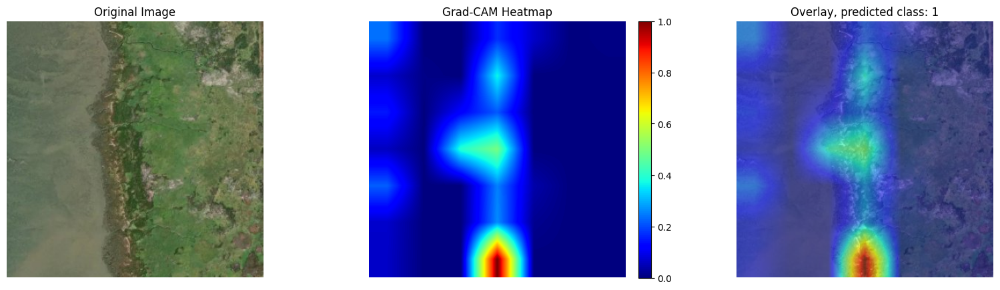

pred calss: 1


In [ ]:
'''test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Step 2: Extract a single image for LIME
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    print(f"Image shape: {img.shape}, Label: {label}")
    break  # We only need one image for LIME'''

cam_extractor = GradCAM(model_loaded, target_layer='layer4')
    # Load and preprocess the image
test_img_path = '/content/wildfire-prediction-dataset/test/nowildfire/-123.199805,49.152146.jpg'
original_img = plt.imread(test_img_path)   # Replace with your actual image path
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))  # Resize to 224x224 as expected by ResNet50
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype('float32') / 255.0

# Convert to NumPy array and add a batch dimension
test_image_arr = np.expand_dims(test_image, axis=0)

# Preprocessing transformation (similar to the one used in training the PyTorch model)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Apply the transformation to the image
test_image_tensor = transform(test_image).unsqueeze(0).to(device)
print(f"Image shape: {test_image_tensor.shape}")
img = test_image_tensor.to(device)

output = model_loaded(img)
pred_class = output.argmax(dim=1).item()
activation_map = cam_extractor(pred_class, output)

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Use Matplotlib to create the heatmap to ensure consistency in color
heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

# Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Overlay the heatmap onto the original image
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Plotting the original image, heatmap, and overlay with a color legend
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title(f'Overlay, predicted class: {pred_class}')

plt.show()
print(f'pred calss: {pred_class}')

  0%|          | 0/1000 [00:00<?, ?it/s]

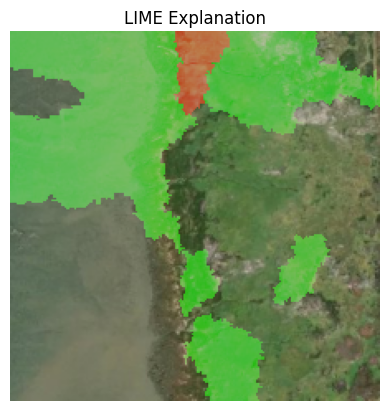

In [ ]:

# Define the prediction function for LIME
def predict_fn(images):
    images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
    outputs = model_loaded(images)
    return torch.softmax(outputs, dim=1).cpu().detach().numpy()

# Initialize LIME explainer for images
explainer = lime_image.LimeImageExplainer()

# Use the explainer to explain predictions
explanation = explainer.explain_instance(
    test_image,  # The original image in NumPy format
    predict_fn,  # Your PyTorch model's prediction function
    top_labels=1,  # Explain the top predicted label
    hide_color=0,  # The color to replace when masking
    num_samples=1000  # Number of perturbations
)

# Get the image explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()

In [ ]:
cam_extractor = GradCAM(model_loaded, target_layer='layer4')

Image shape: torch.Size([1, 3, 224, 224])


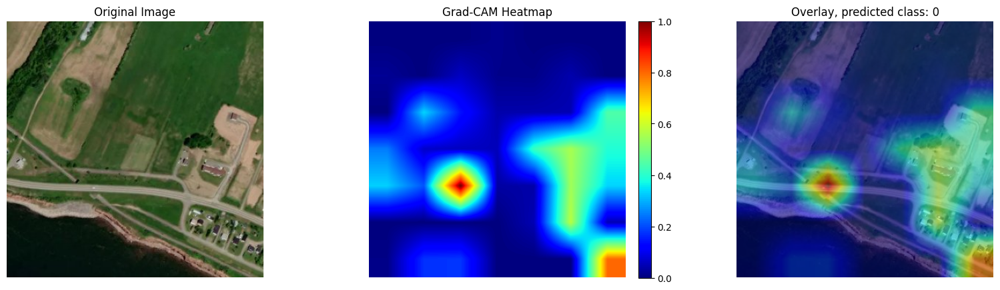

pred calss: 0


In [ ]:
'''test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Step 2: Extract a single image for LIME
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    print(f"Image shape: {img.shape}, Label: {label}")
    break  # We only need one image for LIME'''

    # Load and preprocess the image
test_img_path = '/content/wildfire-prediction-dataset/test/wildfire/-65.6656,48.0986.jpg'
original_img = plt.imread(test_img_path)   # Replace with your actual image path
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))  # Resize to 224x224 as expected by ResNet50
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype('float32') / 255.0

# Convert to NumPy array and add a batch dimension
test_image_arr = np.expand_dims(test_image, axis=0)

# Preprocessing transformation (similar to the one used in training the PyTorch model)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Apply the transformation to the image
test_image_tensor = transform(test_image).unsqueeze(0).to(device)
print(f"Image shape: {test_image_tensor.shape}")
img = test_image_tensor.to(device)

output = model_loaded(img)
pred_class = output.argmax(dim=1).item()
activation_map = cam_extractor(pred_class, output)

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Use Matplotlib to create the heatmap to ensure consistency in color
heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

# Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Overlay the heatmap onto the original image
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Plotting the original image, heatmap, and overlay with a color legend
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title(f'Overlay, predicted class: {pred_class}')

plt.show()
print(f'pred calss: {pred_class}')

  0%|          | 0/1000 [00:00<?, ?it/s]

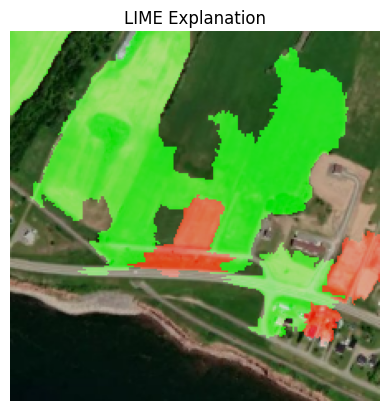

In [ ]:

'''# Define the prediction function for LIME
def predict_fn(images):
    images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
    outputs = model_loaded(images)
    return torch.softmax(outputs, dim=1).cpu().detach().numpy()
'''
# Initialize LIME explainer for images
explainer = lime_image.LimeImageExplainer()

# Use the explainer to explain predictions
explanation = explainer.explain_instance(
    test_image,  # The original image in NumPy format
    predict_fn,  # Your PyTorch model's prediction function
    top_labels=1,  # Explain the top predicted label
    hide_color=0,  # The color to replace when masking
    num_samples=1000  # Number of perturbations
)

# Get the image explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()

In [ ]:
'''test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Step 2: Extract a single image for LIME
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    print(f"Image shape: {img.shape}, Label: {label}")
    break  # We only need one image for LIME'''

    # Load and preprocess the image
test_img_path = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'
original_img = plt.imread(test_img_path)   # Replace with your actual image path
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))  # Resize to 224x224 as expected by ResNet50
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype('float32') / 255.0

# Convert to NumPy array and add a batch dimension
test_image_arr = np.expand_dims(test_image, axis=0)

# Preprocessing transformation (similar to the one used in training the PyTorch model)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Apply the transformation to the image
test_image_tensor = transform(test_image).unsqueeze(0).to(device)


## old and unimportant?

In [ ]:
print(f"Image shape: {test_image_tensor.shape}")

Image shape: torch.Size([1, 3, 224, 224])


In [ ]:
img = test_image_tensor.to(device)

In [ ]:
# Step 4: Forward pass to get the model's output
output = model_loaded(img)
pred_class = output.argmax(dim=1).item()

In [ ]:
activation_map = cam_extractor(pred_class, output)

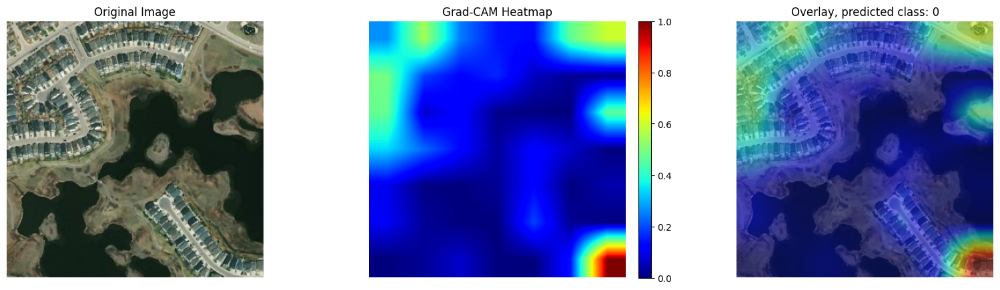

pred calss: 0


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms

'''# Step 1: Load the image using plt.imread
image_file = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'  # Replace with your actual image path
original_img = plt.imread(image_file)

# Step 2: Preprocess the image for the model (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Convert the original image to PIL and then apply the transforms
img_tensor = transform(transforms.ToPILImage()(original_img))

# Add batch dimension
img_tensor = img_tensor.unsqueeze(0).to(device)'''

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Use Matplotlib to create the heatmap to ensure consistency in color
heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

# Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Overlay the heatmap onto the original image
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Plotting the original image, heatmap, and overlay with a color legend
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title(f'Overlay, predicted class: {pred_class}')

plt.show()
print(f'pred calss: {pred_class}')


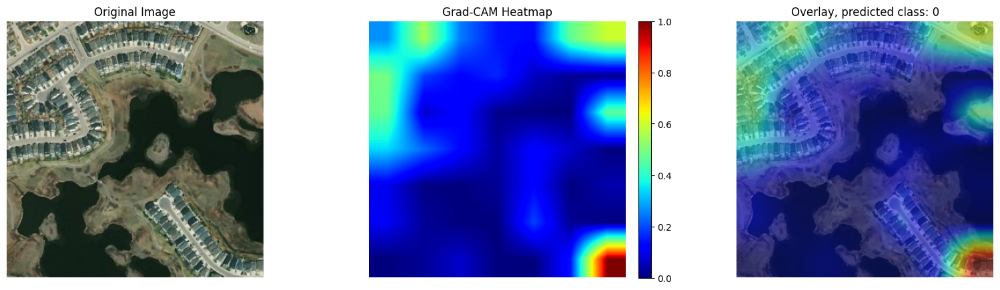

pred calss: 0


In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms

'''# Step 1: Load the image using plt.imread
image_file = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'  # Replace with your actual image path
original_img = plt.imread(image_file)

# Step 2: Preprocess the image for the model (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Convert the original image to PIL and then apply the transforms
img_tensor = transform(transforms.ToPILImage()(original_img))

# Add batch dimension
img_tensor = img_tensor.unsqueeze(0).to(device)'''

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Use Matplotlib to create the heatmap to ensure consistency in color
heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

# Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Overlay the heatmap onto the original image
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Plotting the original image, heatmap, and overlay with a color legend
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title(f'Overlay, predicted class: {pred_class}')

plt.show()
print(f'pred calss: {pred_class}')


  0%|          | 0/1000 [00:00<?, ?it/s]

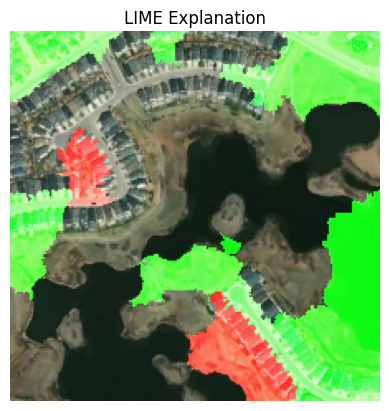

In [ ]:
from lime import lime_image
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch
from torchvision import transforms

'''# Load and preprocess the image
test_img_path = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'    # Replace with your actual image path
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))  # Resize to 224x224 as expected by ResNet50
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype('float32') / 255.0

# Convert to NumPy array and add a batch dimension
test_image_arr = np.expand_dims(test_image, axis=0)

# Preprocessing transformation (similar to the one used in training the PyTorch model)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Apply the transformation to the image
test_image_tensor = transform(test_image).unsqueeze(0).to(device)'''

# Define the prediction function for LIME
def predict_fn(images):
    images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
    outputs = model_loaded(images)
    return torch.softmax(outputs, dim=1).cpu().detach().numpy()

# Initialize LIME explainer for images
explainer = lime_image.LimeImageExplainer()

# Use the explainer to explain predictions
explanation = explainer.explain_instance(
    test_image,  # The original image in NumPy format
    predict_fn,  # Your PyTorch model's prediction function
    top_labels=1,  # Explain the top predicted label
    hide_color=0,  # The color to replace when masking
    num_samples=1000  # Number of perturbations
)

# Get the image explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()


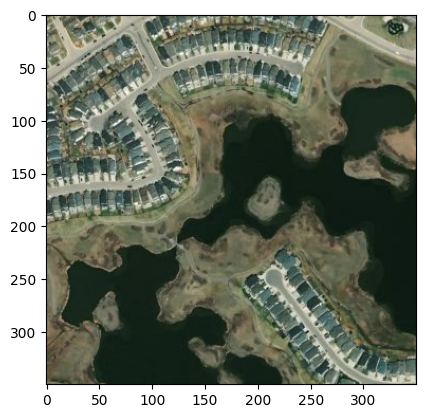

In [ ]:
#test_img_path = "/content/test/wildfire/-59.03238,51.85132.jpg" #wildfire
import matplotlib.image as mpimg
test_img_path = "/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg" #nowildire
image = mpimg.imread(test_img_path)

# Plot the image
imgplot = plt.imshow(image)
#plt.xlabel("Wildfire")
#plt.xlabel("No Wildfire")
plt.show()

In [ ]:
from lime import lime_image
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch
from torchvision import transforms

'''# Load and preprocess the image
test_img_path = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'    # Replace with your actual image path
test_image = cv2.imread(test_img_path)
test_image = cv2.resize(test_image, (224, 224))  # Resize to 224x224 as expected by ResNet50
test_image = cv2.cvtColor(test_image, cv2.COLOR_BGR2RGB)
test_image = test_image.astype('float32') / 255.0

# Convert to NumPy array and add a batch dimension
test_image_arr = np.expand_dims(test_image, axis=0)

# Preprocessing transformation (similar to the one used in training the PyTorch model)
transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Apply the transformation to the image
test_image_tensor = transform(test_image).unsqueeze(0).to(device)'''

# Define the prediction function for LIME
def predict_fn(images):
    images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
    outputs = model_loaded(images)
    return torch.softmax(outputs, dim=1).cpu().detach().numpy()

# Initialize LIME explainer for images
explainer = lime_image.LimeImageExplainer()

# Use the explainer to explain predictions
explanation = explainer.explain_instance(
    test_image,  # The original image in NumPy format
    predict_fn,  # Your PyTorch model's prediction function
    top_labels=1,  # Explain the top predicted label
    hide_color=0,  # The color to replace when masking
    num_samples=1000  # Number of perturbations
)

# Get the image explanation for the top class
temp, mask = explanation.get_image_and_mask(
    explanation.top_labels[0],
    positive_only=False,
    num_features=10,
    hide_rest=False
)

# Display the explanation
plt.imshow(temp)
plt.title("LIME Explanation")
plt.axis('off')
plt.show()


# Applying XAI: Testing with Concept Activation Vectors (TCAV)

## Concept Data Loading and Preprocessing

### Investigate the data

In [15]:
# Define the paths to the concept data
concept_dir = '/content/concept-dataset/images_train_test_val/train'

In [16]:
# Iterate over the images to investigate them

# Dictionary to hold the counts of images and their sizes
folder_image_count = {}
image_sizes = {}

# Iterate through each folder (concept)
for folder_name in os.listdir(concept_dir):
    folder_path = os.path.join(concept_dir, folder_name)
    if os.path.isdir(folder_path):
        folder_image_count[folder_name] = 0
        for image_name in os.listdir(folder_path):
            image_path = os.path.join(folder_path, image_name)
            try:
                with Image.open(image_path) as img:
                    img_size = img.size
                    folder_image_count[folder_name] += 1
                    if img_size not in image_sizes:
                        image_sizes[img_size] = 0
                    image_sizes[img_size] += 1
            except Exception as e:
                print(f"Error loading image {image_path}: {e}")

In [17]:
# Print the number of images per folder
print("Image count per folder:")
for folder, count in folder_image_count.items():
    print(f"{folder}: {count} images")

Image count per folder:
sparseresidential: 350 images
overpass: 350 images
buildings: 350 images
mediumresidential: 350 images
runway: 350 images
tenniscourt: 350 images
freeway: 350 images
mobilehomepark: 350 images
golfcourse: 350 images
river: 350 images
baseballdiamond: 350 images
chaparral: 350 images
agricultural: 350 images
intersection: 350 images
storagetanks: 350 images
forest: 350 images
beach: 350 images
harbor: 350 images
denseresidential: 350 images
parkinglot: 350 images
airplane: 350 images


In [18]:
# Print the different image sizes found
print("\nDifferent image sizes found:")
for size, count in image_sizes.items():
    print(f"Size {size}: {count} images")


Different image sizes found:
Size (256, 256): 7200 images
Size (242, 256): 2 images
Size (250, 256): 7 images
Size (255, 256): 11 images
Size (247, 247): 30 images
Size (256, 254): 6 images
Size (254, 256): 11 images
Size (247, 256): 4 images
Size (256, 253): 11 images
Size (253, 256): 21 images
Size (256, 251): 19 images
Size (256, 249): 7 images
Size (256, 255): 5 images
Size (252, 256): 5 images
Size (249, 256): 4 images
Size (257, 257): 4 images
Size (256, 247): 3 images


### Create functions to load and preprocess the data

In [19]:
# normalize the images
transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
'''    transforms.Normalize(
        mean=mean,
        std=std
    ),'''
])

In [20]:
# Load the dataset with the same transformations defined earlier
'''dataset = datasets.ImageFolder(root='/content/concept-dataset/images_train_test_val/train', transform=transform)'''
concept_dataset = datasets.ImageFolder(root=concept_dir, transform=transforms)
concept_loader = DataLoader(concept_dataset, batch_size=32, shuffle=False, num_workers=4)

In [21]:
# Define helper function to load the concept images as a tensor from a filename
def get_tensor_from_filename(filename):
    # Load the image using cv2
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Convert to use torchvision.transforms
    img = Image.fromarray(img)

    # Apply the transform function
    return data_transforms(img)

In [22]:
# Define a helper function to load and transform the class images
def load_image_tensors(class_name, root_path, apply_transform=True):
    path = os.path.join(root_path, class_name)
    filenames = glob.glob(path + '/*.jpg')

    tensors = []
    for filename in filenames:
        # Load the image using cv2
        img = cv2.imread(filename)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Convert to use torchvision.transforms
        img = Image.fromarray(img)

        # Apply the transform and append the tensor
        tensors.append(transform(img) if apply_transform else img)

    return tensors

In [23]:
# Define a helper function to load and transform the images for the predefined concepts
def assemble_concept(name, id, concepts_path=concept_dir):
    concept_path = os.path.join(concepts_path, name) + "/"

    # Use CustomIterableDataset and dataset_to_dataloader from Captum to load the data
    dataset = CustomIterableDataset(get_tensor_from_filename, concept_path)
    concept_iter = dataset_to_dataloader(dataset)

    # Create and return the Concept object with a data iterator
    return Concept(id=id, name=name, data_iter=concept_iter)

### Prepare the data
The data for the classes is sampled to work with limited computing power. 500 Random samples are used per class.

Moreover, concepts are split into concepts of interest and remaining concepts. From the remaining concepts, the random folders are constructed. The random forlders encompass images of multiple concepts that are not the construct of interest but of the same domain. These are used to test the significance against

In [24]:
# To work with limited computing power, wildfire data is sampled for TCAV.
# 500 images are randomly sampled from wildfire and nowildfire and copied to the target directories

# Setup
# Paths to source directories
wildfire_src = '/content/wildfire-prediction-dataset/train/wildfire'
nowildfire_src = '/content/wildfire-prediction-dataset/train/nowildfire'

! mkdir /content/sampled_classes
sampled_classes = '/content/sampled_classes'

# Paths for samples data classes
wildfire_dest = os.path.join(sampled_classes, 'wildfire')
nowildfire_dest = os.path.join(sampled_classes, 'nowildfire')

# Create directories
os.makedirs(wildfire_dest, exist_ok=True)
os.makedirs(nowildfire_dest, exist_ok=True)

num_images_to_copy = 500

In [25]:
# Copy images
# Copy wildfire images
wildfire_images = random.sample(os.listdir(wildfire_src), num_images_to_copy)
for img in wildfire_images:
    shutil.copy(os.path.join(wildfire_src, img), wildfire_dest)

# Copy nowildfire images
nowildfire_images = random.sample(os.listdir(nowildfire_src), num_images_to_copy)
for img in nowildfire_images:
    shutil.copy(os.path.join(nowildfire_src, img), nowildfire_dest)

# Diagnostic prints to ensure correct behavior
print(f"Copied {len(os.listdir(wildfire_dest))} images to the wildfire folder.")
print(f"Copied {len(os.listdir(nowildfire_dest))} images to the nowildfire folder.")

Copied 500 images to the wildfire folder.
Copied 500 images to the nowildfire folder.


In [26]:
# Define the subset of concepts of interest out of all concepts
wildfire_base_path = '/content/sampled_classes/'
#landuse_base_path = '/content/concept-dataset/images_train_test_val/train/'


                   # List of all concept names and the subset of concepts you're interested in
concept_names = ['agricultural', 'airplane', 'baseballdiamond', 'beach', 'buildings',
                 'chaparral', 'denseresidential', 'forest', 'freeway', 'golfcourse',
                 'harbor', 'intersection', 'mediumresidential', 'mobilehomepark',
                 'overpass', 'parkinglot', 'river', 'runway', 'sparseresidential',
                 'storagetanks', 'tenniscourt']

subset_concepts = ['forest', 'freeway','denseresidential']

In [27]:
# Create random folders with the remaining concepts to test against

# set number of random folders
num_random_exp = 10
random_folders = [f'random_{i}' for i in range(num_random_exp)]
remaining_concepts = list(set(concept_names) - set(subset_concepts))

# Prepare a pool of image paths from remaining concepts without reuse
random_pool = []

# Iterate over remaining concepts and store file paths
print("\nCreating a pool of image paths from remaining concepts...")
for concept in remaining_concepts:
    concept_src_path = os.path.join(concept_dir, concept)
    concept_images = os.listdir(concept_src_path)
    random_pool.extend([(concept_src_path, img) for img in concept_images])

# Shuffle the random pool (remaining concept image paths) to ensure randomness
random.shuffle(random_pool)

# Diagnostic print to check the size of the random pool
print(f"Total images available in random pool: {len(random_pool)}")


Creating a pool of image paths from remaining concepts...
Total images available in random pool: 6300


In [28]:
# Distribute the images of the remaining concepts to the random folders

! mkdir /content/random

# Distribute paths to random folders with the naming convention "random500_x" (Original TCAV naming convention)
print("\nDistributing images to random folders...")
images_per_folder = len(random_pool) // num_random_exp

for i in range(num_random_exp):
    # Generate folder names like "random500_0", "random500_1", etc.
    random_folder_name = f"random500_{i}"
    random_folder_path = os.path.join("/content/random", random_folder_name)
    os.makedirs(random_folder_path, exist_ok=True)

    # Get the paths for this folder
    folder_images = random_pool[i * images_per_folder:(i + 1) * images_per_folder]

    # Copy the images from their source paths to the random folder
    for src_path, img in folder_images:
        shutil.copy(os.path.join(src_path, img), random_folder_path)

    # Diagnostic print
    print(f"Assigned {len(os.listdir(random_folder_path))} images to folder: {random_folder_name}")


Distributing images to random folders...
Assigned 630 images to folder: random500_0
Assigned 630 images to folder: random500_1
Assigned 630 images to folder: random500_2
Assigned 630 images to folder: random500_3
Assigned 630 images to folder: random500_4
Assigned 630 images to folder: random500_5
Assigned 630 images to folder: random500_6
Assigned 630 images to folder: random500_7
Assigned 630 images to folder: random500_8
Assigned 630 images to folder: random500_9


### Assemble the concept to test

In [29]:
# Assemble the specific concepts and random concepts

# Assemble concepts of interest
#agricultural_concept = assemble_concept("agricultural", 0, concepts_path=concept_dir)
#beach_concept = assemble_concept("beach", 1, concepts_path=concept_dir)
forest_concept = assemble_concept("forest", 0, concepts_path=concept_dir)
denseresidential_concept = assemble_concept("denseresidential", 1, concepts_path=concept_dir)
freeway_concept = assemble_concept("freeway", 2, concepts_path=concept_dir)

# Assemble the random concepts
random_0_concept = assemble_concept("random500_0", 3, concepts_path="/content/random")
random_1_concept = assemble_concept("random500_1", 4, concepts_path="/content/random")
random_2_concept = assemble_concept("random500_2", 5, concepts_path="/content/random")
random_3_concept = assemble_concept("random500_3", 6, concepts_path="/content/random")
random_4_concept = assemble_concept("random500_4", 7, concepts_path="/content/random")
random_5_concept = assemble_concept("random500_5", 8, concepts_path="/content/random")
random_6_concept = assemble_concept("random500_6", 9, concepts_path="/content/random")
random_7_concept = assemble_concept("random500_7", 10, concepts_path="/content/random")
random_8_concept = assemble_concept("random500_8", 11, concepts_path="/content/random")
random_9_concept = assemble_concept("random500_9", 12, concepts_path="/content/random")

### Visualize concepts of interest and random concepts

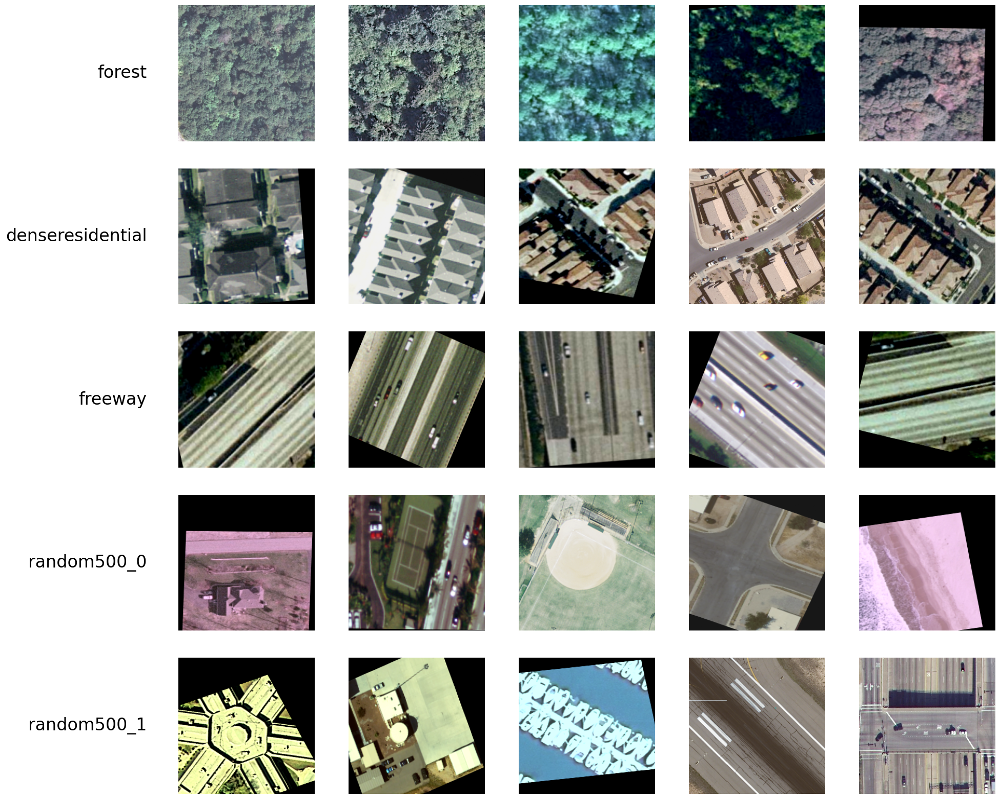

In [30]:
# Number of figures and concepts to visualize
n_figs = 5
n_concepts = 5  # Adjust this based on the number of concepts you want to visualize

# List your concepts here
#concepts = [agricultural_concept, beach_concept, forest_concept, random_0_concept, random_1_concept]
#concepts = [agricultural_concept, beach_concept, forest_concept, denseresidential_concept, freeway_concept]
concepts = [forest_concept, denseresidential_concept, freeway_concept, random_0_concept, random_1_concept]

# Prepare the figure and axes
fig, axs = plt.subplots(n_concepts, n_figs + 1, figsize=(25, 4 * n_concepts))

# Iterate over each concept and its corresponding subplot row
for c, concept in enumerate(concepts):
    # Use the appropriate path based on whether the concept is random or not
    if 'random' in concept.name:
        concept_path = os.path.join("/content/random", concept.name) + "/"
    else:
        concept_path = os.path.join(concept_dir, concept.name) + "/"

    img_files = glob.glob(concept_path + '*')

    for i, img_file in enumerate(img_files[:n_figs + 1]):
        if os.path.isfile(img_file):
            if i == 0:
                axs[c, i].text(1.0, 0.5, str(concept.name), ha='right', va='center', family='sans-serif', size=24)
            else:
                img = plt.imread(img_file)
                axs[c, i].imshow(img)

            axs[c, i].axis('off')

# Display the plots
plt.show()


## Computing TCAV Scores

### Setup

In [31]:
# Print the model to get layer name(s)
print(model_loaded)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [31]:
# Check which index belongs to which class name of the wildfire classification
dataset = datasets.ImageFolder(root=train_dir)
class_to_idx = dataset.class_to_idx
print(class_to_idx)

{'nowildfire': 0, 'wildfire': 1}


In [32]:
# Set Wildfire class index
wildfire_ind = 1
nowildfire_ind = 0

### Load the class images

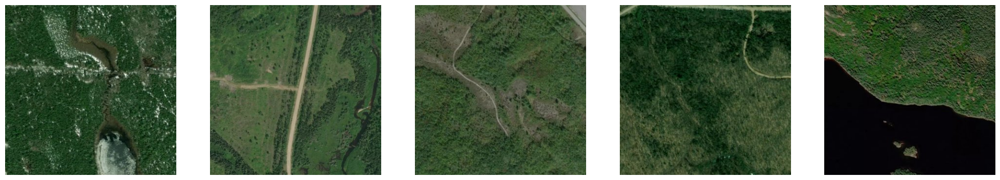

In [33]:
# Load the images for class of interest (wildfire) and visualize the ensure correct behavior
wildfire_imgs = load_image_tensors('wildfire', root_path="/content/sampled_classes", apply_transform=False)

fig, axs = plt.subplots(1, 5, figsize = (25, 5))
axs[0].imshow(wildfire_imgs[40])
axs[1].imshow(wildfire_imgs[41])
axs[2].imshow(wildfire_imgs[34])
axs[3].imshow(wildfire_imgs[31])
axs[4].imshow(wildfire_imgs[30])

axs[0].axis('off')
axs[1].axis('off')
axs[2].axis('off')
axs[3].axis('off')
axs[4].axis('off')

plt.show()


In [34]:
# Convert wildfire images to tensors
wildfire_tensors = torch.stack([data_transforms(img) for img in wildfire_imgs])

## General Concept comparison

In [35]:
experimental_set_concepts = [[forest_concept, denseresidential_concept, freeway_concept]]

In [36]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']
#layer = ['layer1','layer4']

# Set up TCAV
mytcav_concepts = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [37]:
# Calculate the TCAV scores
tcav_scores_concepts = mytcav_concepts.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
#tcav_scores_w_random
print(tcav_scores_concepts)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945d66710>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.2260, 0.7140, 0.8320]), 'magnitude': tensor([-0.1441,  0.0986,  0.0708])}, 'layer2': {'sign_count': tensor([0.0020, 0.9740, 0.9020]), 'magnitude': tensor([-0.2640,  0.1754,  0.0796])}, 'layer3': {'sign_count': tensor([0.4660, 0.4280, 0.0820]), 'magnitude': tensor([ 0.0004, -0.0038, -0.0387])}, 'layer4': {'sign_count': tensor([1., 0., 1.]), 'magnitude': tensor([ 0.1375, -0.1222,  0.0208])}})})


In [38]:
#Auxiliary functions for visualizing of TCAV score
def format_float(f):
    return float('{:.3f}'.format(f) if abs(f) >= 0.0005 else '{:.3e}'.format(f))

def plot_tcav_scores(experimental_sets, tcav_scores, layers):
    fig, ax = plt.subplots(1, len(experimental_sets), figsize=(20, 5))

    barWidth = 1 / (len(experimental_sets[0]) + 1)

    for idx_es, concepts in enumerate(experimental_sets):
        concepts_key = concepts_to_str(concepts)
        pos = [np.arange(len(layers))]
        for i in range(1, len(concepts)):
            pos.append([(x + barWidth) for x in pos[i-1]])

        _ax = (ax[idx_es] if len(experimental_sets) > 1 else ax)
        for i in range(len(concepts)):
            val = [format_float(scores['sign_count'][i]) for layer, scores in tcav_scores[concepts_key].items()]
            # Print the shape and type of `val` for debugging
            print(f"Concept: {concepts[i].name}")
            print(f"Values: {val}")
            print(f"Type of val: {type(val)}")
            print(f"Length of val: {len(val)}\n")

            _ax.bar(pos[i], val, width=barWidth, edgecolor='white', label=concepts[i].name)

        # Add xticks on the middle of the group bars
        _ax.set_xlabel('Set {}'.format(str(idx_es)), fontweight='bold', fontsize=8)
        _ax.set_xticks([r + 0.3 * barWidth for r in range(len(layers))])
        _ax.set_xticklabels(layers, fontsize=8)

        # Create legend & Show graphic
        _ax.legend(fontsize=8)

    plt.show()


Concept: forest
Values: [0.226, 0.002, 0.466, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.714, 0.974, 0.428, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.832, 0.902, 0.082, 1.0]
Type of val: <class 'list'>
Length of val: 4



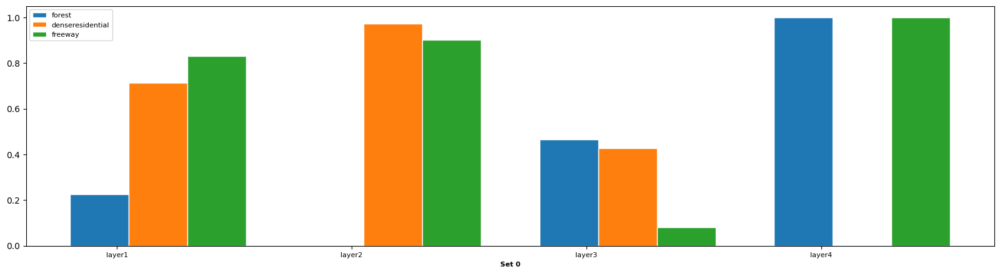

In [39]:
plot_tcav_scores(experimental_set_concepts, tcav_scores_concepts, layer)

# Evaluation

##Forest

### Define experimantal sets for CAV

In [40]:
# Define the experimental set with target concepts paired with random concepts
# to test significance against

experimental_set_forest = [
    [forest_concept, random_0_concept],
    [forest_concept, random_1_concept],
    [forest_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]


In [41]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']
#layer = ['layer1','layer4']

# Set up TCAV
mytcav_forest = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))


/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


### Calculate the TCAV scores

In [42]:
# Calculate the TCAV scores
tcav_scores_forest = mytcav_forest.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_forest,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
#tcav_scores_w_random
print(tcav_scores_forest)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945fd3520>, {'0-3': defaultdict(None, {'layer1': {'sign_count': tensor([0.8100, 0.1900]), 'magnitude': tensor([ 0.1538, -0.1538])}, 'layer2': {'sign_count': tensor([0.0360, 0.9640]), 'magnitude': tensor([-0.1144,  0.1144])}, 'layer3': {'sign_count': tensor([0.4060, 0.5940]), 'magnitude': tensor([-0.0047,  0.0047])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.0405, -0.0405])}}), '0-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.5400, 0.4600]), 'magnitude': tensor([ 0.0100, -0.0100])}, 'layer2': {'sign_count': tensor([0.0200, 0.9800]), 'magnitude': tensor([-0.1221,  0.1221])}, 'layer3': {'sign_count': tensor([0.7920, 0.2080]), 'magnitude': tensor([ 0.0235, -0.0235])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0164,  0.0164])}}), '0-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.4620, 0.5380]), 'magnitude': tensor([-0.0105,  0.0105])}, 'layer2': {'sign_coun

### Visualize the results

Concept: forest
Values: [0.81, 0.036, 0.406, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.19, 0.964, 0.594, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [0.54, 0.02, 0.792, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.46, 0.98, 0.208, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [0.462, 0.002, 0.818, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.538, 0.998, 0.182, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class 'list'>
Length of val: 4

Conce

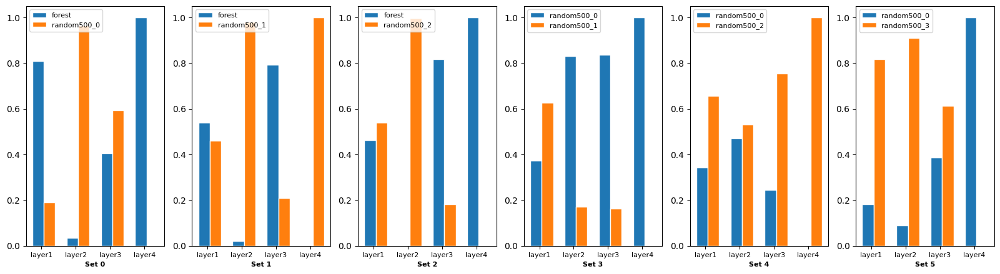

In [43]:
# Plot the scores with the defined functions
plot_tcav_scores(experimental_set_forest, tcav_scores_forest, layer)

In [44]:
# Investigate the detailed scores
for concept_pair, layers_dict in tcav_scores_forest.items():
    print(f"Concept Pair: {concept_pair}")
    for layer, scores in layers_dict.items():
        print(f"  Layer: {layer}")
        print(f"    Sign Count: {scores['sign_count']}")
        print(f"    Magnitude: {scores['magnitude']}")

Concept Pair: 0-3
  Layer: layer1
    Sign Count: tensor([0.8100, 0.1900])
    Magnitude: tensor([ 0.1538, -0.1538])
  Layer: layer2
    Sign Count: tensor([0.0360, 0.9640])
    Magnitude: tensor([-0.1144,  0.1144])
  Layer: layer3
    Sign Count: tensor([0.4060, 0.5940])
    Magnitude: tensor([-0.0047,  0.0047])
  Layer: layer4
    Sign Count: tensor([1., 0.])
    Magnitude: tensor([ 0.0405, -0.0405])
Concept Pair: 0-4
  Layer: layer1
    Sign Count: tensor([0.5400, 0.4600])
    Magnitude: tensor([ 0.0100, -0.0100])
  Layer: layer2
    Sign Count: tensor([0.0200, 0.9800])
    Magnitude: tensor([-0.1221,  0.1221])
  Layer: layer3
    Sign Count: tensor([0.7920, 0.2080])
    Magnitude: tensor([ 0.0235, -0.0235])
  Layer: layer4
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0164,  0.0164])
Concept Pair: 0-5
  Layer: layer1
    Sign Count: tensor([0.4620, 0.5380])
    Magnitude: tensor([-0.0105,  0.0105])
  Layer: layer2
    Sign Count: tensor([0.0020, 0.9980])
    Magnitude:

### Statistical significance testing of concepts

Now, let's define a convenience function for assembling the experiments together as lists of Concept objects, creating and running the TCAV:

In [45]:
def assemble_scores(tcav_scores, experimental_sets, idx, score_layer, score_type):
    score_list = []
    for concepts in experimental_sets:
        score_list.append(tcav_scores["-".join([str(c.id) for c in concepts])][score_layer][score_type][idx])

    return score_list

In addition, it is interesting to look into the p-values of statistical significance tests for each concept. We say, that we reject null hypothesis, if the p-value for concept's TCAV scores is smaller than 0.05. This indicates that the concept is important for model prediction.

We label concept populations as overlapping if p-value > 0.05 otherwise disjoint.

In [46]:
def get_pval(tcav_scores, experimental_set, score_layer, score_type, alpha=0.05, print_ret=False):

    P1 = assemble_scores(tcav_scores, experimental_set, 0, score_layer, score_type)
    P2 = assemble_scores(tcav_scores, experimental_set, 1, score_layer, score_type)

    if print_ret:
        print('P1[mean, std]: ', format_float(np.mean(P1)), format_float(np.std(P1)))
        print('P2[mean, std]: ', format_float(np.mean(P2)), format_float(np.std(P2)))

    _, pval = ttest_ind(P1, P2)

    if print_ret:
        print("p-values:", format_float(pval))

    if pval < alpha:    # alpha value is 0.05 or 5%
        relation = "Disjoint"
        if print_ret:
            print("Disjoint")
    else:
        relation = "Overlap"
        if print_ret:
            print("Overlap")
    #print(f"P1:{P1}")
    #print(f"P2:{P2}")
    return P1, P2, format_float(pval), relation


We now run the TCAV and obtain the scores:

In [47]:
n = 3
def show_boxplots(tcav_scores, experimental_set, layer, metric='sign_count'):

    def format_label_text(experimental_set):
        concept_id_list = [exp.name if i == 0 else \
                             exp.name.split('_')[0] for i, exp in enumerate(experimental_set[0])]
        return concept_id_list

    n_plots = 2

    fig, ax = plt.subplots(1, n_plots, figsize = (25, 7 * 1))
    fs = 18
    for i in range(n_plots):
        esl = experimental_set[i * n : (i+1) * n]
        print(f"esl: {esl}")
        P1, P2, pval, relation = get_pval(tcav_scores, esl, layer, metric)

        ax[i].set_ylim([0, 1])
        ax[i].set_title(layer + "-" + metric + " (pval=" + str(pval) + " - " + relation + ")", fontsize=fs)
        ax[i].boxplot([P1, P2], showfliers=True)

        ax[i].set_xticklabels(format_label_text(esl), fontsize=fs)

    plt.show()

We can present the distribution of tcav scores using boxplots and the p-values indicating whether TCAV scores of those concepts are overlapping or disjoint.

Below box plots visualize the distribution of TCAV scores for two pairs of concepts in three different layers. Each layer is visualized in a separate jupyter cell.
Below diagrams show that `striped` concept has TCAV scores that are consistently high across all layers and experimental sets as apposed to `random` concept. It also shows that `striped` and `random` are disjoint populations.

When we compare the populations of two random concepts we see that the p-value is much higher, meaning that those populations overlap and we cannot reject null hypothesis anymore.

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


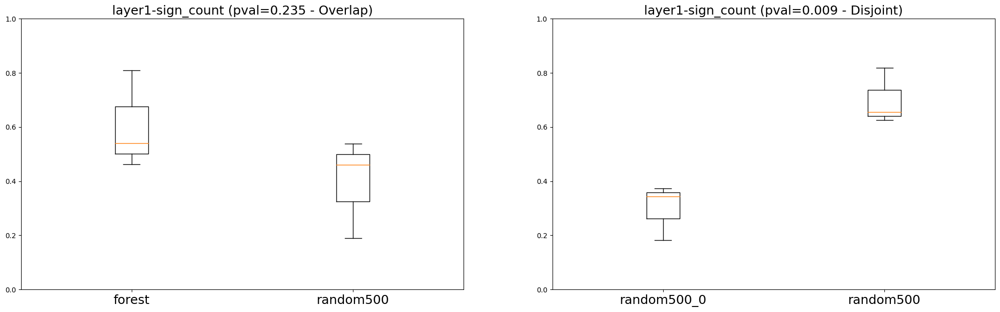

In [48]:
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer1")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


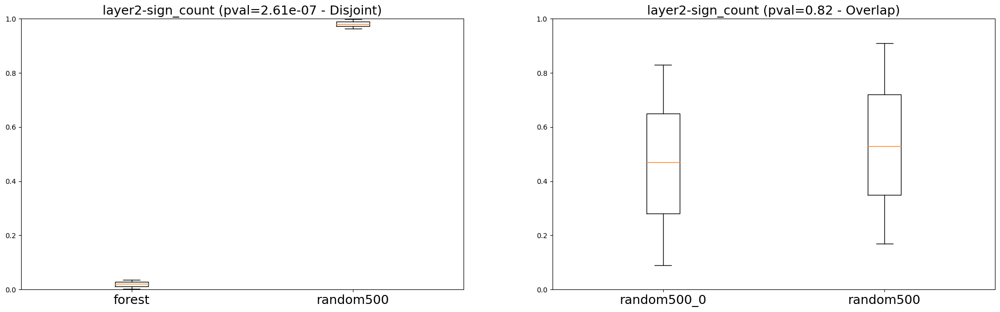

In [49]:
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer2")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


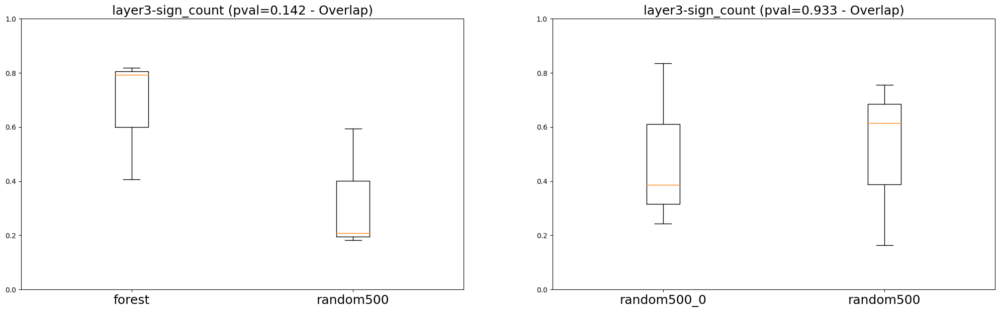

In [50]:
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer3")

esl: [[Concept(0, 'forest'), Concept(3, 'random500_0')], [Concept(0, 'forest'), Concept(4, 'random500_1')], [Concept(0, 'forest'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


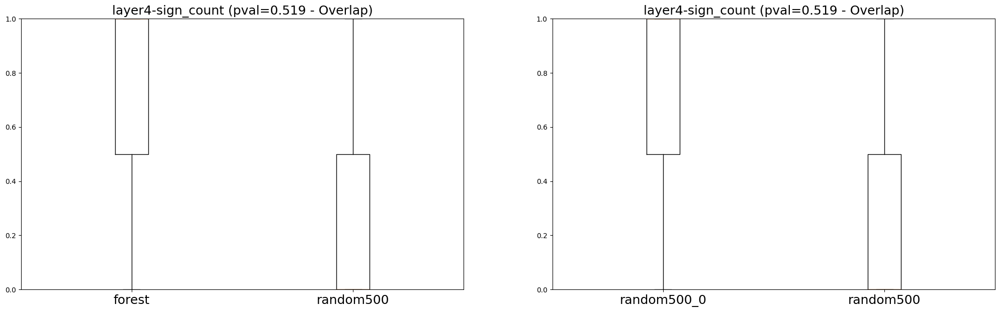

In [51]:
show_boxplots (tcav_scores_forest, experimental_set_forest, "layer4")

## Denseresidential

### Define experimantal sets for CAV

In [52]:
# Define the experimental set with target concepts paired with random concepts
# to test significance against

experimental_set_denseresidential = [
    [denseresidential_concept, random_0_concept],
    [denseresidential_concept, random_1_concept],
    [denseresidential_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]


In [53]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']

# Set up TCAV
mytcav_denseresidential = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))


/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


### Calculate the TCAV scores

In [54]:
# Calculate the TCAV scores
tcav_scores_denseresidential = mytcav_denseresidential.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_denseresidential,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
#tcav_scores_w_random
print(tcav_scores_denseresidential)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)
/usr/local/lib/pytho

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af945cf1120>, {'1-3': defaultdict(None, {'layer1': {'sign_count': tensor([0.9720, 0.0280]), 'magnitude': tensor([ 0.2392, -0.2392])}, 'layer2': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.1407, -0.1407])}, 'layer3': {'sign_count': tensor([0.2340, 0.7660]), 'magnitude': tensor([-0.0239,  0.0239])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.1291,  0.1291])}}), '1-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.9220, 0.0780]), 'magnitude': tensor([ 0.1883, -0.1883])}, 'layer2': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.2250, -0.2250])}, 'layer3': {'sign_count': tensor([0.1260, 0.8740]), 'magnitude': tensor([-0.0339,  0.0339])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0727,  0.0727])}}), '1-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.8540, 0.1460]), 'magnitude': tensor([ 0.1233, -0.1233])}, 'layer2': {'sign_coun

### Visualize the results

Concept: denseresidential
Values: [0.972, 0.99, 0.234, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.028, 0.01, 0.766, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.922, 0.99, 0.126, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.078, 0.01, 0.874, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.854, 0.984, 0.256, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.146, 0.016, 0.744, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class

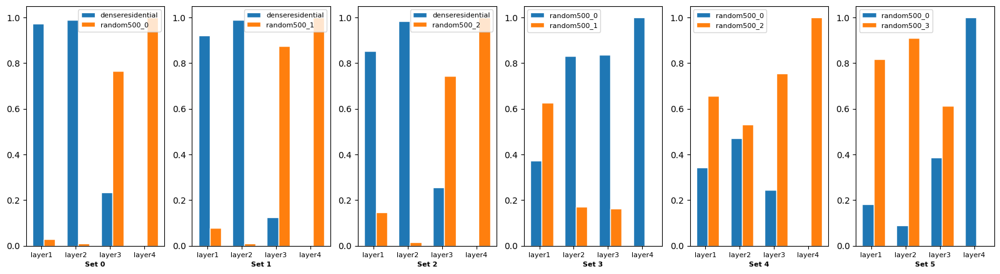

In [55]:
# Plot the scores with the defined functions
plot_tcav_scores(experimental_set_denseresidential, tcav_scores_denseresidential, layer)

### Statistical significance testing of concepts

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


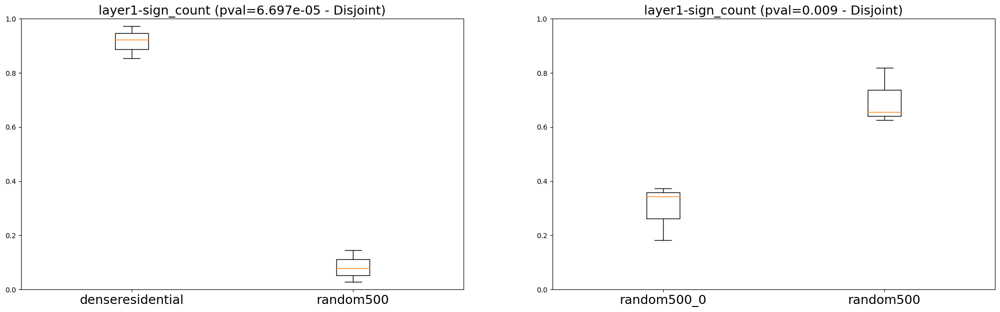

In [56]:
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer1")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


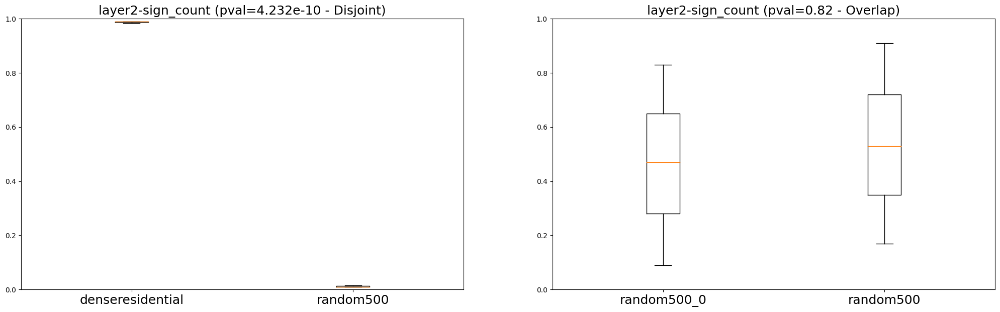

In [57]:
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer2")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


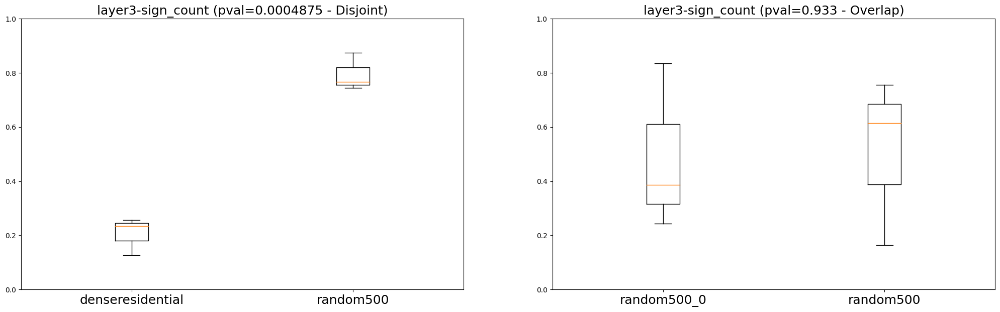

In [58]:
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer3")

esl: [[Concept(1, 'denseresidential'), Concept(3, 'random500_0')], [Concept(1, 'denseresidential'), Concept(4, 'random500_1')], [Concept(1, 'denseresidential'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


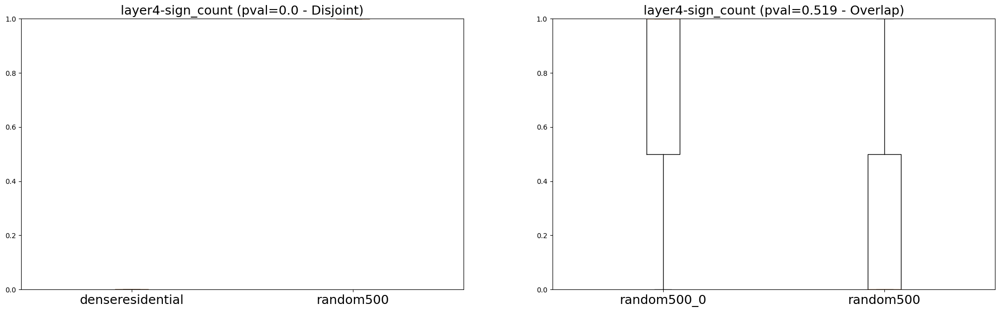

In [59]:
show_boxplots (tcav_scores_denseresidential, experimental_set_denseresidential, "layer4")

## Freeway

### Define experimantal sets for CAV

In [60]:
# Define the experimental set with target concepts paired with random concepts
# to test significance against

experimental_set_freeway = [
    [freeway_concept, random_0_concept],
    [freeway_concept, random_1_concept],
    [freeway_concept, random_2_concept],
    [random_0_concept, random_1_concept],
    [random_0_concept, random_2_concept],
    [random_0_concept, random_3_concept]
    ]


In [61]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']

# Set up TCAV
mytcav_freeway = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))


/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


### Calculate the TCAV scores

In [62]:
# Calculate the TCAV scores
tcav_scores_freeway = mytcav_freeway.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_freeway,
                                        target=wildfire_ind,
                                        n_steps=8,
                                       )
#tcav_scores_w_random
print(tcav_scores_freeway)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)
/usr/local/lib/pytho

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af8381faa70>, {'2-3': defaultdict(None, {'layer1': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.4263, -0.4263])}, 'layer2': {'sign_count': tensor([0.6500, 0.3500]), 'magnitude': tensor([ 0.0219, -0.0219])}, 'layer3': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0879,  0.0879])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0255,  0.0255])}}), '2-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.9880, 0.0120]), 'magnitude': tensor([ 0.2957, -0.2957])}, 'layer2': {'sign_count': tensor([0.7940, 0.2060]), 'magnitude': tensor([ 0.0696, -0.0696])}, 'layer3': {'sign_count': tensor([0.2940, 0.7060]), 'magnitude': tensor([-0.0190,  0.0190])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.0006, -0.0006])}}), '2-5': defaultdict(None, {'layer1': {'sign_count': tensor([0.9900, 0.0100]), 'magnitude': tensor([ 0.3201, -0.3201])}, 'layer2': {'sign_count': tensor([0.37

### Visualize the results

Concept: freeway
Values: [1.0, 0.65, 0.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.0, 0.35, 1.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.988, 0.794, 0.294, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.012, 0.206, 0.706, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.99, 0.378, 0.002, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.01, 0.622, 0.998, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.374, 0.83, 0.836, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [0.626, 0.17, 0.164, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.344, 0.47, 0.244, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_2
Values: [0.656, 0.53, 0.756, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept:

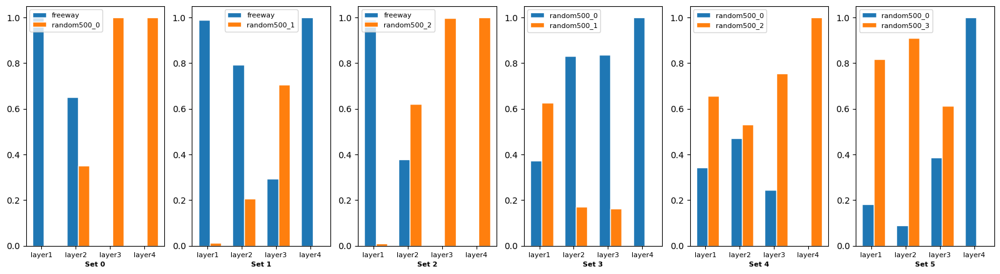

In [63]:
# Plot the scores with the defined functions
plot_tcav_scores(experimental_set_freeway, tcav_scores_freeway, layer)

### Statistical significance testing of concepts

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


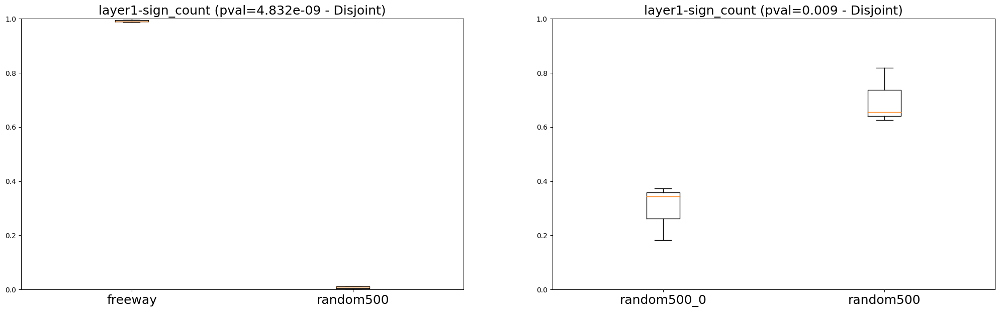

In [64]:
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer1")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


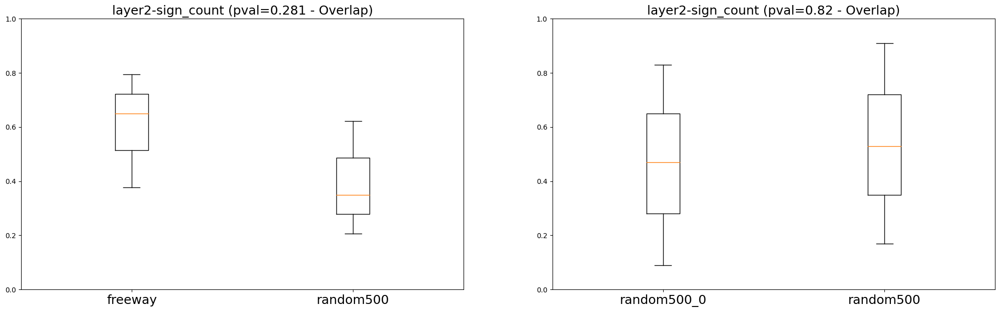

In [65]:
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer2")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


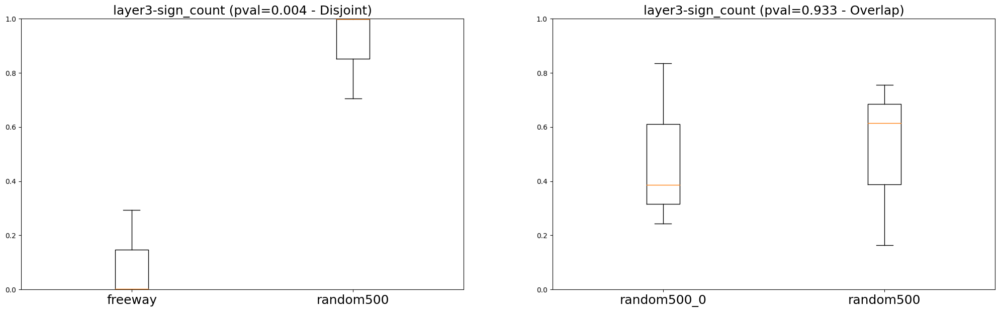

In [66]:
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer3")

esl: [[Concept(2, 'freeway'), Concept(3, 'random500_0')], [Concept(2, 'freeway'), Concept(4, 'random500_1')], [Concept(2, 'freeway'), Concept(5, 'random500_2')]]
esl: [[Concept(3, 'random500_0'), Concept(4, 'random500_1')], [Concept(3, 'random500_0'), Concept(5, 'random500_2')], [Concept(3, 'random500_0'), Concept(6, 'random500_3')]]


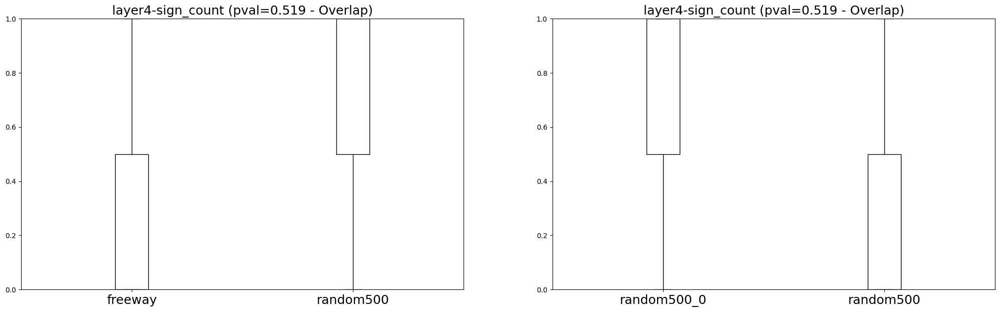

In [67]:
show_boxplots (tcav_scores_freeway, experimental_set_freeway, "layer4")

## Oposite class

In [68]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']
#layer = ['layer1','layer4']

# Set up TCAV
mytcav_opposite = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))

/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [69]:
# Calculate the TCAV scores
tcav_scores_opposite = mytcav_opposite.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_concepts,
                                        target=nowildfire_ind,
                                        n_steps=8,
                                       )
#tcav_scores_w_random
print(tcav_scores_opposite)

/usr/local/lib/python3.10/dist-packages/captum/concept/_core/cav.py:165: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  save_dict = torch.load(cavs_path)


defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7af8513f36d0>, {'0-1-2': defaultdict(None, {'layer1': {'sign_count': tensor([0.7760, 0.2820, 0.1700]), 'magnitude': tensor([ 0.1442, -0.1021, -0.0702])}, 'layer2': {'sign_count': tensor([0.9980, 0.0200, 0.0980]), 'magnitude': tensor([ 0.2669, -0.1799, -0.0777])}, 'layer3': {'sign_count': tensor([0.5460, 0.5360, 0.9220]), 'magnitude': tensor([0.0005, 0.0017, 0.0397])}, 'layer4': {'sign_count': tensor([0., 1., 0.]), 'magnitude': tensor([-0.1415,  0.1240, -0.0151])}})})


Concept: forest
Values: [0.776, 0.998, 0.546, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: denseresidential
Values: [0.282, 0.02, 0.536, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: freeway
Values: [0.17, 0.098, 0.922, 0.0]
Type of val: <class 'list'>
Length of val: 4



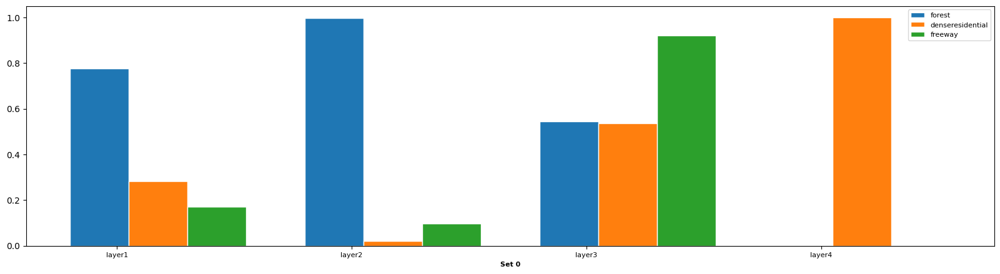

In [70]:
plot_tcav_scores(experimental_set_concepts, tcav_scores_opposite, layer)

## Concepts as Input

In [71]:
concept_test_dir = "/content/concept-dataset/images_train_test_val/test"
# Assuming you already have a trained model, load the model
# model = your_trained_model
model_loaded.eval()  # Set the model to evaluation mode

# Load concept data using the same transformations and loader
concept_dataset_tests = datasets.ImageFolder(root=concept_test_dir, transform=data_transforms, loader=cv2_loader)
concept_loader_tests = DataLoader(concept_dataset_tests, batch_size=32, shuffle=False)

# Define a list to store the results
results = []

# Define a mapping from folder names (concepts) to the class index
concept_class_mapping = {v: k for k, v in concept_dataset_tests.class_to_idx.items()}

# Iterate through the concept_loader
for inputs, labels in concept_loader_tests:
    inputs = inputs.to(device)  # Move inputs to the appropriate device (GPU/CPU)
    labels = labels.to(device)  # Move labels to the appropriate device

    # Get model predictions
    outputs = model_loaded(inputs)
    _, preds = torch.max(outputs, 1)

    # Iterate over the batch
    for i in range(inputs.size(0)):
        concept_label = concept_class_mapping[labels[i].item()]  # Get the original concept label (folder name)
        wildfire_classification = 'wildfire' if preds[i].item() == 1 else 'no wildfire'  # Assuming 1 is wildfire and 0 is no wildfire

        # Append the result to the list
        results.append({
            'concept': concept_label,
            'classification': wildfire_classification
        })

# Convert results to a pandas DataFrame for easier analysis
results_df = pd.DataFrame(results)

In [72]:
results_df.head()

,concept,classification
0,agricultural,no wildfire
1,agricultural,no wildfire
2,agricultural,no wildfire
3,agricultural,no wildfire
4,agricultural,wildfire


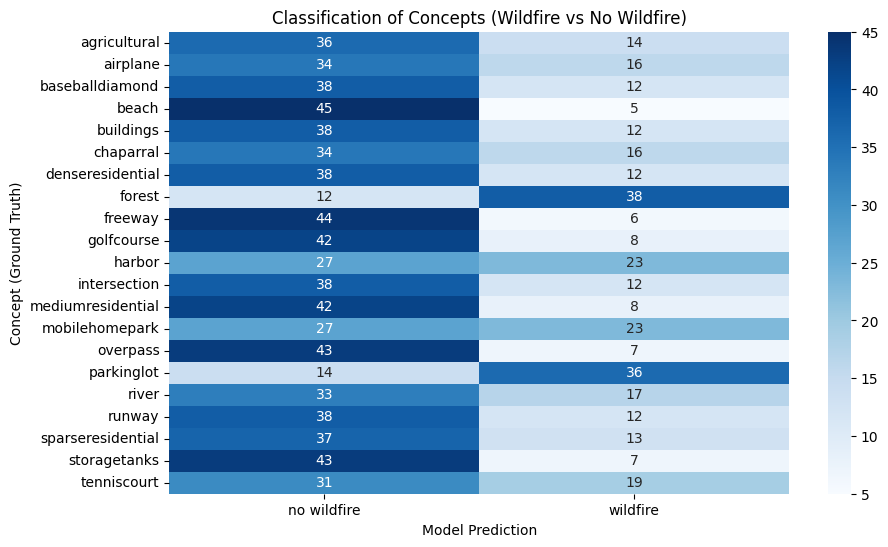

In [73]:
# Assuming results_df is already created with columns 'concept' and 'classification'
# We will create a pivot table (similar to a confusion matrix)

# Count how often each concept is classified as "wildfire" or "no wildfire"
confusion_matrix_data = pd.crosstab(results_df['concept'], results_df['classification'])

# Plotting the confusion matrix-style graph
plt.figure(figsize=(10, 6))
sns.heatmap(confusion_matrix_data, annot=True, fmt="d", cmap="Blues")

# Add labels and title
plt.title("Classification of Concepts (Wildfire vs No Wildfire)")
plt.xlabel("Model Prediction")
plt.ylabel("Concept (Ground Truth)")

# Show the plot
plt.show()


In [74]:
! mkdir /content/evaluation
# Define source directories from the test set / unused ranodm folders
concept_folders = {
    'forest_concept': '/content/concept-dataset/images_train_test_val/test/forest',
    'denseresidential_concept': '/content/concept-dataset/images_train_test_val/test/sparseresidential',
    'freeway_concept': '/content/concept-dataset/images_train_test_val/test/freeway',
    'random_3_concept': '/content/random/random500_3',
    'random_4_concept': '/content/random/random500_4'
}

# Define the destination directory where all concepts will be copied
destination_dir = "/content/evaluation"

# Loop over each concept folder and copy it to the destination
for concept, src_dir in concept_folders.items():
    dest_dir = os.path.join(destination_dir, concept)  # Create a destination path for each concept

    # Copy the entire folder to the new destination
    if os.path.exists(dest_dir):
        print(f"Destination folder {dest_dir} already exists, skipping copy.")
    else:
        shutil.copytree(src_dir, dest_dir)  # Copy the entire folder
        print(f"Copied {concept} to {dest_dir}")

# Diagnostic print
print(f"Copied all concept folders to {destination_dir}.")


Copied forest_concept to /content/evaluation/forest_concept
Copied denseresidential_concept to /content/evaluation/denseresidential_concept
Copied freeway_concept to /content/evaluation/freeway_concept
Copied random_3_concept to /content/evaluation/random_3_concept
Copied random_4_concept to /content/evaluation/random_4_concept
Copied all concept folders to /content/evaluation.


In [75]:
# Assuming you already have a trained model, load the model
# model = your_trained_model
model_loaded.eval()  # Set the model to evaluation mode
evaluation_dir = '/content/evaluation'

# Load concept data using the same transformations and loader
concept_dataset_evaluation = datasets.ImageFolder(root=evaluation_dir, transform=data_transforms, loader=cv2_loader)
concept_loader_evaluation = DataLoader(concept_dataset_evaluation, batch_size=32, shuffle=False)

# Define a list to store the results
results = []

# Define a mapping from folder names (concepts) to the class index
concept_class_mapping = {v: k for k, v in concept_dataset_evaluation.class_to_idx.items()}

# Iterate through the concept_loader
for inputs, labels in concept_loader_evaluation:
    inputs = inputs.to(device)  # Move inputs to the appropriate device (GPU/CPU)
    labels = labels.to(device)  # Move labels to the appropriate device

    # Get model predictions
    outputs = model_loaded(inputs)
    _, preds = torch.max(outputs, 1)

    # Iterate over the batch
    for i in range(inputs.size(0)):
        concept_label = concept_class_mapping[labels[i].item()]  # Get the original concept label (folder name)
        wildfire_classification = 'wildfire' if preds[i].item() == 1 else 'no wildfire'  # Assuming 1 is wildfire and 0 is no wildfire

        # Append the result to the list
        results.append({
            'concept': concept_label,
            'classification': wildfire_classification
        })

# Convert results to a pandas DataFrame for easier analysis
evaluation_results_df = pd.DataFrame(results)

In [76]:
evaluation_results_df.head()

,concept,classification
0,denseresidential_concept,no wildfire
1,denseresidential_concept,no wildfire
2,denseresidential_concept,no wildfire
3,denseresidential_concept,wildfire
4,denseresidential_concept,no wildfire


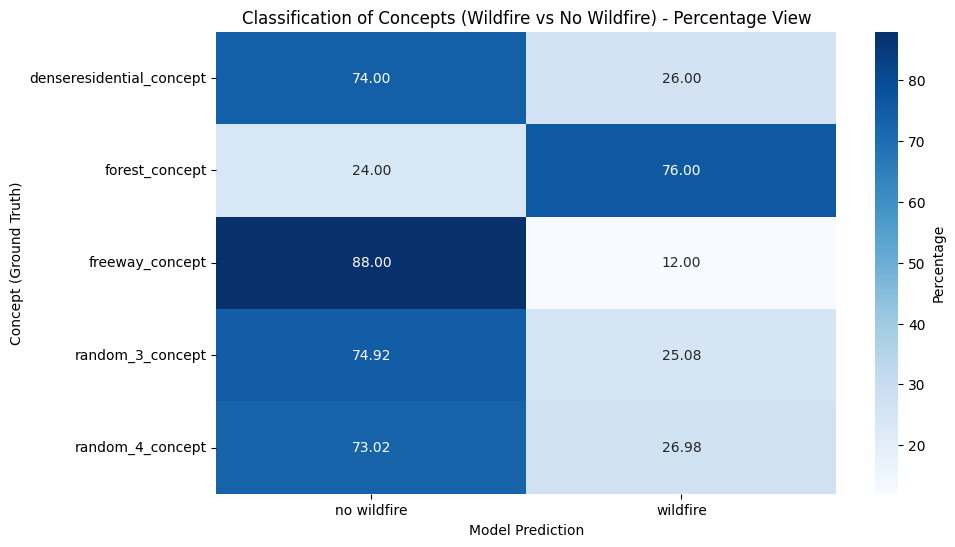

In [77]:
# Assuming results_df is already created with columns 'concept' and 'classification'
# We will create a pivot table (confusion matrix)

# Count how often each concept is classified as "wildfire" or "no wildfire"
confusion_matrix_evaluation = pd.crosstab(evaluation_results_df['concept'], evaluation_results_df['classification'])

# Normalize the confusion matrix to display percentages
confusion_matrix_normalized = confusion_matrix_evaluation.div(confusion_matrix_evaluation.sum(axis=1), axis=0) * 100

# Plotting the confusion matrix with percentages
plt.figure(figsize=(10, 6))
sns.heatmap(confusion_matrix_normalized, annot=True, fmt=".2f", cmap="Blues", cbar_kws={'label': 'Percentage'})

# Add labels and title
plt.title("Classification of Concepts (Wildfire vs No Wildfire) - Percentage View")
plt.xlabel("Model Prediction")
plt.ylabel("Concept (Ground Truth)")

# Show the plot
plt.show()
